# Primer Analisis EDA y Filtrado de los Datos 

## Preparacion

In [1]:
# Importo librerías
import pandas as pd
import numpy as np
import psycopg2
import matplotlib.pyplot as plt
import seaborn as sns
import random
import matplotlib.image as mpimg

In [29]:
# Importo mis funciones personalizadas
import custom_functions as cf

## Conexion a la base de datos

In [3]:
# Obtengo las credenciales para la conexion.
import os
from dotenv import load_dotenv

load_dotenv() # Cargo las variables de entorno guardadas en el archivo .env.

db_username = os.getenv('DB_USERNAME')
db_password = os.getenv('DB_PASSWORD')
db_host = os.getenv('DB_HOST')
db_port = os.getenv('DB_PORT')
db_name = os.getenv('DB_NAME')

In [4]:
# Creo la conexión a la base de datos en PostgreSQL.
try:
    connection = psycopg2.connect(
        user=db_username,
        password=db_password,
        host=db_host,
        port=db_port,
        database=db_name
    )
    cursor = connection.cursor()
    print("¡Conexion exitosa a la base de datos!")
    print('')

    # Datos de la tabla 'jugadores'.
    query = "SELECT * FROM jugadores"
    data_jugadores = pd.read_sql(query, connection)
    print("Datos de la tabla 'jugadores':")
    print(data_jugadores.sample(7))
    print('')

     # Datos de la tabla 'partidos'.
    query = "SELECT * FROM partidos"
    data_partidos = pd.read_sql(query, connection)
    print("Datos de la tabla 'partidos':")
    print(data_partidos.sample(7))
    print('')

     # Datos de la tabla 'goles'.
    query = "SELECT * FROM goles"
    data_goles = pd.read_sql(query, connection)
    print("Datos de la tabla 'goles':")
    print(data_goles.sample(7))
    print('')

    
     # Datos de la tabla 'posiciones'.
    query = "SELECT * FROM posiciones"
    data_posiciones = pd.read_sql(query, connection)
    print("Datos de la tabla 'posiciones':")
    print(data_posiciones.sample(7))
    print('')

except Exception as error:
    print("Error al conectar a la base de datos:", error)

finally:
    if connection:
        cursor.close()
        connection.close()
        print("¡Conexion cerrada!")

¡Conexion exitosa a la base de datos!

Datos de la tabla 'jugadores':
     player_id   player_name
120        120     strafinho
94          94        <Polo>
79          79       nahiara
39          39  pitote gordo
139        139           jax
95          95       JONKLER
109        109           Ema

Datos de la tabla 'partidos':
     match_id              start_time                end_time
15         16 2025-01-09 00:12:06.139 2025-01-09 00:12:11.075
68         69 2025-01-09 06:15:51.049 2025-01-09 06:17:38.064
20         21 2025-01-09 00:21:35.351 2025-01-09 00:21:49.566
126       127 2025-01-16 05:58:02.697 2025-01-16 06:00:44.314
132       133 2025-01-16 06:14:34.866 2025-01-16 06:14:43.323
77         78 2025-01-09 06:42:54.332 2025-01-09 06:43:23.816
88         89 2025-01-11 18:19:11.726 2025-01-11 18:21:08.484

Datos de la tabla 'goles':
      id  match_id  player_id      player_name equipo        tick
193  262        79         48          marco!"    Red   15.966667
135  204   

C:\Users\ASROCK\AppData\Local\Temp\ipykernel_17656\988966875.py:16: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  data_jugadores = pd.read_sql(query, connection)
C:\Users\ASROCK\AppData\Local\Temp\ipykernel_17656\988966875.py:23: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  data_partidos = pd.read_sql(query, connection)
C:\Users\ASROCK\AppData\Local\Temp\ipykernel_17656\988966875.py:30: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  data_goles = pd.read_sql(query, connection)
C:\Users\ASROCK\AppData\Local\Temp\ipykernel_176

Datos de la tabla 'posiciones':
          id  match_id  player_id           x           y  velocity_x  \
77391  79706       119          2 -180.000952   78.819080 -134.092116   
63535  65850        97        100  181.960484  -83.097377 -161.355689   
19848  22163        41          0  169.473141  232.059251  271.781541   
89453  91768       134        130  199.506428  108.815071   69.808359   
67897  70212       102        107  470.096782 -181.376890  109.876297   
67638  69953       102        107  227.298160   67.712641   36.170757   
3472    5787        12          9  423.201570    2.049614   -8.979147   

       velocity_y        time team  
77391   58.227449   73.383333    1  
63535    1.064499  158.133333    2  
19848  231.283306   17.116667    0  
89453   22.242705    6.383333    2  
67897   38.128350  130.033333    1  
67638  -29.111976   93.033333    1  
3472     0.507092  158.533333    2  

¡Conexion cerrada!


In [5]:
# Guardo los datos crudos en la carpeta '/raw_data'
ruta_archivo = os.path.join('./raw_data', 'data_jugadores.csv')
data_jugadores.to_csv(ruta_archivo, index=False)

ruta_archivo = os.path.join('./raw_data', 'data_partidos.csv')
data_partidos.to_csv(ruta_archivo, index=False)

ruta_archivo = os.path.join('./raw_data', 'data_posiciones.csv')
data_posiciones.to_csv(ruta_archivo, index=False)

ruta_archivo = os.path.join('./raw_data', 'data_goles.csv')
data_goles.to_csv(ruta_archivo, index=False)

## Analisis exploratorio
Exploro los datos de las tablas.

### Imagen de la cancha para plotear

In [6]:
background_image = mpimg.imread('stadium.PNG')

### Conteos de valores

In [7]:
# Analizo la cantidad de repeticiones de valores en las columnas seleccionadas en las tablas seleccionadas.
columns_goles = ['match_id', 'player_name', 'equipo']
columns_posiciones = ['match_id', 'player_id']

cf.print_value_counts(data_goles, 'data_goles', 5, columns_goles)
cf.print_value_counts(data_posiciones, 'data_posiciones', 5, columns_posiciones)

Value counts para data_goles - Columna: match_id
match_id
63     6
72     5
122    5
51     5
99     5
Name: count, dtype: int64


Value counts para data_goles - Columna: player_name
player_name
tnt        51
marco!"    20
Tuc        16
MATT       10
smd         9
Name: count, dtype: int64


Value counts para data_goles - Columna: equipo
equipo
Red     184
Blue    174
Name: count, dtype: int64


Value counts para data_posiciones - Columna: match_id
match_id
25     2409
76     1946
92     1750
104    1582
58     1540
Name: count, dtype: int64


Value counts para data_posiciones - Columna: player_id
player_id
0      14824
2      11134
48      3618
120     3342
112     3283
Name: count, dtype: int64




In [8]:
# Agrupo por match_id y tick, y cuento la cantidad de aparariciones de cada grupo.
# Esto vendria a contar la cantidad de entidades 'entities' en el momento 'match_id - time'.
data_grouped_entities = data_posiciones.groupby(['match_id', 'time']).size().reset_index(name='entities')

print("DataFrame con el conteo de grupos:")
print('')
data_grouped_entities.sample(10)

DataFrame con el conteo de grupos:



,match_id,time,entities
4679,55,37.650000,7
8181,89,6.200000,7
10629,108,14.700000,5
11928,122,35.100000,7
8856,93,44.100000,7
1988,24,2.283333,7
2047,25,1.500000,7
13776,138,129.616667,7
4891,58,28.116667,7
8473,91,79.216667,7


In [9]:
# Observo la cantidad de momentos en los que hubo cierta cantidad de entidades (lo ideal es 7: 3 reds, 3 blues, 1 ball). 
columns_grouped_entities = ['time', 'entities']
cf.print_value_counts(data_grouped_entities, 'data_grouped_entities' , 20, columns_grouped_entities)

Value counts para data_grouped_entities - Columna: time
time
0.000000      53
180.000000    16
1.983333      13
0.983333      13
2.983333      13
3.983333      12
4.983333      10
6.983333      10
7.983333      10
8.983333      10
5.983333      10
9.983333       8
10.983333      8
11.983333      8
12.983333      7
13.983333      7
1.183333       6
0.183333       6
3.183333       6
2.183333       6
Name: count, dtype: int64


Value counts para data_grouped_entities - Columna: entities
entities
7     12399
5       632
3       570
6       469
2       275
4       163
28       18
35       13
21       10
42        5
8         3
15        2
9         1
12        1
77        1
56        1
24        1
27        1
98        1
60        1
Name: count, dtype: int64




### Partidos en los que siempre hubieron 7 entidades en la cancha
Estos son, probablemente, los partidos mas relevantes a anaizar y los mas útiles para entrenar al modelo, aunque no serán los únicos.

In [10]:
# Contar las ocurrencias por match_id y time
counts_per_time = data_posiciones.groupby(['match_id', 'time']).size().reset_index(name='count')

# Filtrar match_ids donde siempre hay 7 entidades en cada momento
matches_with_always_7ents = counts_per_time[counts_per_time['count'] == 7]['match_id'].unique()

# Verificar si un match_id tiene menos de 7 en algún momento
always_7ents_match_ids = [
    match_id for match_id in matches_with_always_7ents
    if counts_per_time[counts_per_time['match_id'] == match_id]['count'].nunique() == 1
]

always_7ents_match_ids

[17,
 20,
 23,
 24,
 29,
 30,
 31,
 32,
 42,
 43,
 46,
 51,
 52,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 64,
 68,
 69,
 70,
 71,
 72,
 73,
 77,
 78,
 79,
 90,
 99,
 102,
 103,
 104,
 109,
 111,
 116,
 117,
 123,
 127,
 128,
 135,
 136,
 137,
 142,
 144,
 145]

### Agrupo datos para EDA

In [11]:
# Agrupo momentos con sus entidades
time_counts = data_grouped_entities['time'].value_counts().sort_index()
data_time_counts = time_counts.reset_index()
data_time_counts.columns = ['time', 'count']

# Agrupo momentos con sus entidades y filtro los momentos que tengan exactamente 7 entidades
data_grouped_entities_7ents = data_grouped_entities[data_grouped_entities['entities'] == 7]
time_counts_7ents = data_grouped_entities_7ents['time'].value_counts().sort_index()
data_time_counts_7ents = time_counts_7ents.reset_index()
data_time_counts_7ents.columns = ['time', 'count']

### Cantidad de partidos por cantidad de goles y resultados

C:\Users\ASROCK\AppData\Local\Temp\ipykernel_17656\3131938590.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=goal_counts, x='total_goals', palette='Greens')


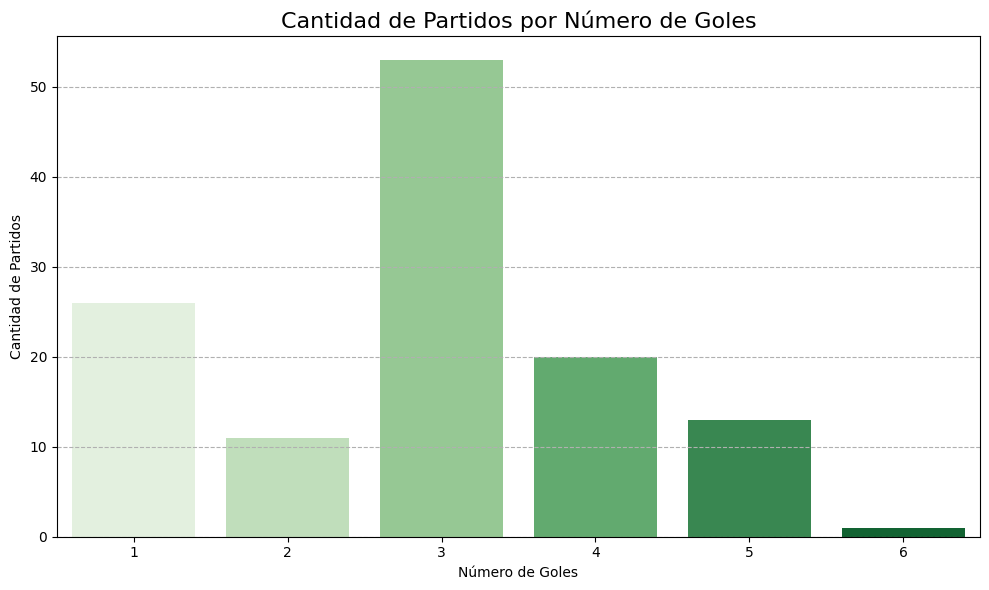

In [12]:
# Obtener la cantidad de goles por partido
goal_counts = data_goles.groupby('match_id').size().reset_index(name='total_goals')

# Crear barplot de la distribución de goles por partido
plt.figure(figsize=(10, 6))
sns.countplot(data=goal_counts, x='total_goals', palette='Greens')
plt.title('Cantidad de Partidos por Número de Goles', fontsize=16)
plt.xlabel('Número de Goles')
plt.ylabel('Cantidad de Partidos')
plt.xticks()
plt.grid(axis='y', linestyle='--')
plt.tight_layout()
plt.show()

In [13]:
# Filtrar partidos con el máximo time entre 179 y 180
matches_grouped = data_posiciones.groupby('match_id')['time'].max().reset_index()
matches_that_finished_by_time_limit = matches_grouped[(matches_grouped['time'] >= 179) & (matches_grouped['time'] <= 180)]

# Filtrar partidos con el máximo time menor a 179 y un ganador con 3 goles o más
matches_that_finished_by_red_or_blue_win = matches_grouped[matches_grouped['time'] < 179]
match_results = data_goles.groupby(['match_id', 'equipo']).size().unstack(fill_value=0).reset_index()
match_results.columns = ['match_id', 'Blue', 'Red']

# Filtrar para los partidos donde el ganador tiene 3 goles o más
match_results['Red'] = match_results['Red'].astype(int)
match_results['Blue'] = match_results['Blue'].astype(int)

match_results_filtered = match_results[(match_results['Red'] >= 3) | (match_results['Blue'] >= 3)]
matches_that_finished_by_red_or_blue_win = matches_that_finished_by_red_or_blue_win[matches_that_finished_by_red_or_blue_win['match_id'].isin(match_results_filtered['match_id'])]

# Filtrar partidos con el máximo time mayor a 180 y con un ganador
matches_that_finished_after_180 = matches_grouped[matches_grouped['time'] > 180]
matches_that_finished_after_180 = matches_that_finished_after_180[matches_that_finished_after_180['match_id'].isin(match_results['match_id'])]

# Concatenar todos los partidos válidos
valid_matches = pd.concat([
    matches_that_finished_by_time_limit,
    matches_that_finished_by_red_or_blue_win,
    matches_that_finished_after_180
])

# Combinar con los resultados de goles
valid_matches_with_results = match_results.merge(valid_matches, on='match_id')

# Añadir la columna de resultado como texto
valid_matches_with_results['Resultado'] = valid_matches_with_results.apply(
    lambda row: f"{int(row['Red'])}-{int(row['Blue'])}", axis=1
)

# Añadir la columna de "Modo de victoria" para indicar cómo terminó cada partido
valid_matches_with_results['Modo_Victoria'] = valid_matches_with_results['time'].apply(
    lambda x: 'Antes del 180' if x < 179 else ('En el 180' if 179 <= x <= 181 else 'Después del 180')
)

# Filtrar los partidos con resultados relevantes
valid_matches_with_results_filtered = valid_matches_with_results[
    (valid_matches_with_results['Red'] != valid_matches_with_results['Blue']) | 
    (valid_matches_with_results['Red'] >= 3) | 
    (valid_matches_with_results['Blue'] >= 3)
]

# Mostrar el DataFrame resultante
print(valid_matches_with_results_filtered)

    match_id  Blue  Red        time Resultado  Modo_Victoria
0          3     3    0   99.716667       0-3  Antes del 180
1          4     3    1  109.983333       1-3  Antes del 180
2          7     3    0   76.350000       0-3  Antes del 180
3         12     2    1  180.000000       1-2      En el 180
4         13     3    2  149.650000       2-3  Antes del 180
..       ...   ...  ...         ...       ...            ...
88       140     1    0  180.000000       0-1      En el 180
89       141     0    3   68.600000       3-0  Antes del 180
90       144     0    3   85.233333       3-0  Antes del 180
91       146     3    1  179.266667       1-3      En el 180
92       149     1    0  180.000000       0-1      En el 180

[93 rows x 6 columns]


In [14]:
valid_matches_with_results_filtered['Modo_Victoria'].value_counts()

Modo_Victoria
Antes del 180      65
En el 180          17
Después del 180    11
Name: count, dtype: int64

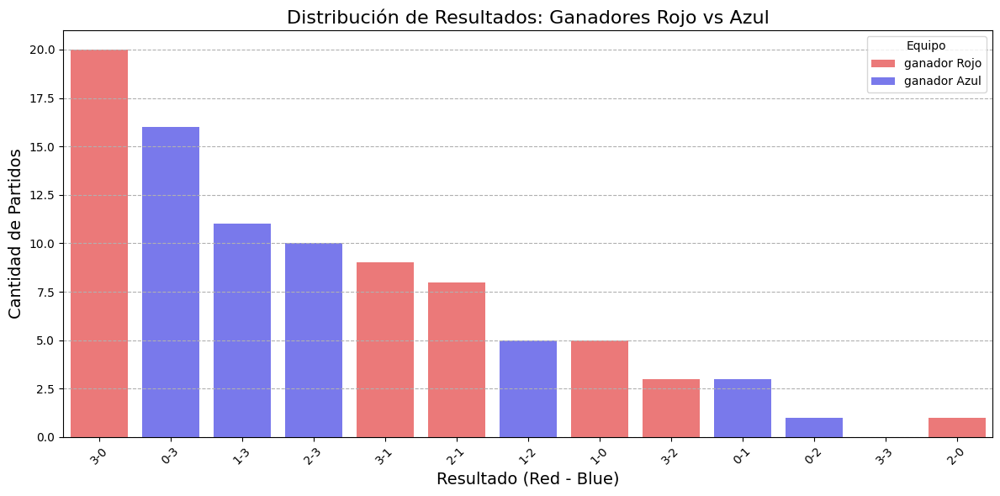

In [15]:
# Dividir los datos para los partidos ganados por el equipo rojo y azul
matches_red_wins  = valid_matches_with_results_filtered[valid_matches_with_results_filtered['Red'] > valid_matches_with_results_filtered['Blue']]
matches_blue_wins = valid_matches_with_results_filtered[valid_matches_with_results_filtered['Blue'] > valid_matches_with_results_filtered['Red']]

# Encontrar el máximo conteo de los resultados para ajustar los límites del gráfico
max_red_wins_count = matches_red_wins['Resultado'].value_counts().max()
max_blue_wins_count = matches_blue_wins['Resultado'].value_counts().max()
max_count = max(max_red_wins_count, max_blue_wins_count)

# Crear el gráfico en una sola figura
plt.figure(figsize=(12, 6))

# Barplot para el equipo rojo
sns.countplot(data=matches_red_wins, x='Resultado', order=valid_matches_with_results_filtered['Resultado'].value_counts().index, color='red', label='Rojo', alpha=0.6)

# Barplot para el equipo azul, superpuesto al gráfico rojo
sns.countplot(data=matches_blue_wins, x='Resultado', order=valid_matches_with_results_filtered['Resultado'].value_counts().index, color='blue', label='Azul', alpha=0.6)

# Ajustes de título, etiquetas y leyenda
plt.title('Distribución de Resultados: Ganadores Rojo vs Azul', fontsize=16)
plt.xlabel('Resultado (Red - Blue)', fontsize=14)
plt.ylabel('Cantidad de Partidos', fontsize=14)
plt.ylim(0, max_count + 1)
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--')

# Mostrar leyenda
plt.legend(title='Equipo', labels=['ganador Rojo', 'ganador Azul'], loc='upper right')

# Mostrar el gráfico
plt.tight_layout()
plt.show()

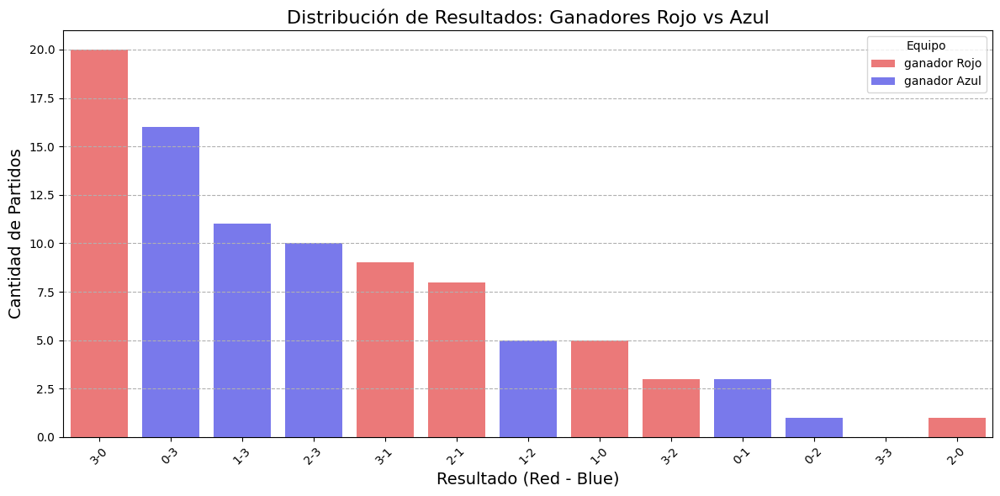

In [16]:
# Dividir los datos para los partidos ganados por el equipo rojo y azul
matches_red_wins  = valid_matches_with_results_filtered[valid_matches_with_results_filtered['Red'] > valid_matches_with_results_filtered['Blue']]
matches_blue_wins = valid_matches_with_results_filtered[valid_matches_with_results_filtered['Blue'] > valid_matches_with_results_filtered['Red']]

# Encontrar el máximo conteo de los resultados para ajustar los límites del gráfico
max_red_wins_count = matches_red_wins['Resultado'].value_counts().max()
max_blue_wins_count = matches_blue_wins['Resultado'].value_counts().max()
max_count = max(max_red_wins_count, max_blue_wins_count)

# Crear el gráfico en una sola figura
plt.figure(figsize=(12, 6))

# Barplot para el equipo rojo
sns.countplot(data=matches_red_wins, x='Resultado', order=valid_matches_with_results_filtered['Resultado'].value_counts().index, color='red', label='Rojo', alpha=0.6)

# Barplot para el equipo azul, superpuesto al gráfico rojo
sns.countplot(data=matches_blue_wins, x='Resultado', order=valid_matches_with_results_filtered['Resultado'].value_counts().index, color='blue', label='Azul', alpha=0.6)

# Ajustes de título, etiquetas y leyenda
plt.title('Distribución de Resultados: Ganadores Rojo vs Azul', fontsize=16)
plt.xlabel('Resultado (Red - Blue)', fontsize=14)
plt.ylabel('Cantidad de Partidos', fontsize=14)
plt.ylim(0, max_count + 1)
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--')

# Mostrar leyenda
plt.legend(title='Equipo', labels=['ganador Rojo', 'ganador Azul'], loc='upper right')

# Mostrar el gráfico
plt.tight_layout()
plt.show()

### Distribucion de los ticks en los momentos captados en los partidos

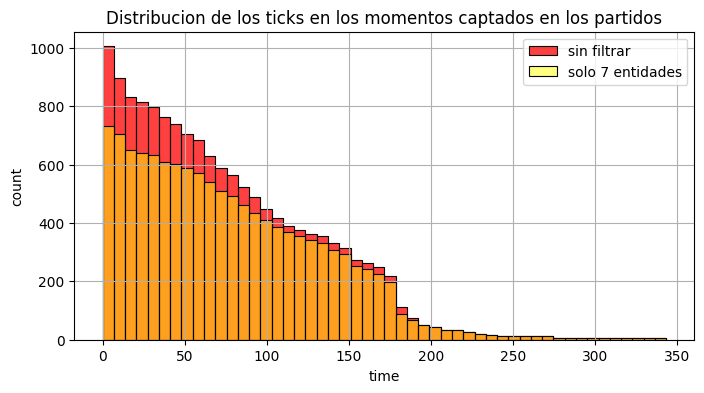

In [17]:
# Histograma de la distribucion de los ticks en los momentos captados en los partidos
plt.figure(figsize=(8, 4))

h1 = sns.histplot(data_time_counts, x='time', weights='count', color='red', kde=False, bins=50, label='sin filtrar')
h2 = sns.histplot(data_time_counts_7ents, x='time', weights='count', color='yellow', alpha=0.5, kde=False, bins=50, label='solo 7 entidades')

plt.title('Distribucion de los ticks en los momentos captados en los partidos')
plt.xlabel('time')
plt.ylabel('count')

handles, labels = plt.gca().get_legend_handles_labels()
plt.legend(handles, labels, loc='upper right')

plt.grid(True)

plt.show()

El histograma muestra la distribución de los ticks de los momentos de los partidos que fueron recoilados. En rojo grafico se muestran todos, en amarillo a los pertenecientes a momentos con 7 entidades exactamente en la cancha, y en naranja cuando ambas barras se solapan (es de esperar que no se vea amarillo, y solo naranja).

Notar que la duración estándar de un partido es de 300 ticks, pero puede terminar antes si un equipo mete 3 goles, o puede terminar despues si en el tick 300 el partido va empatado.



### Distribucion de goles a lo largo de los ticks

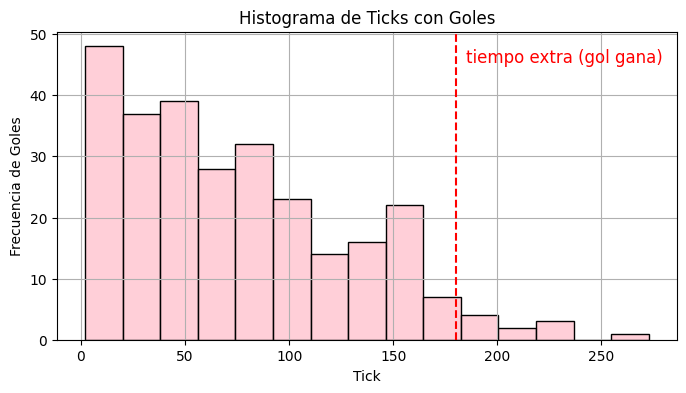

In [18]:
plt.figure(figsize=(8,4))

# Crear el histograma
sns.histplot(data=data_goles, x='tick', bins=15, kde=False, color='pink')

# Añadir una línea punteada en el valor 180 del eje x
plt.axvline(x=180, color='red', linestyle='--')

# Añadir un texto a la derecha de la línea
plt.text(185, plt.gca().get_ylim()[1] * 0.9, 'tiempo extra (gol gana)', color='red', fontsize=12)

# Configurar el título y las etiquetas de los ejes
plt.title('Histograma de Ticks con Goles')
plt.xlabel('Tick')
plt.ylabel('Frecuencia de Goles')
plt.grid(True)

# Mostrar el gráfico
plt.show()

### Momentos de partidos

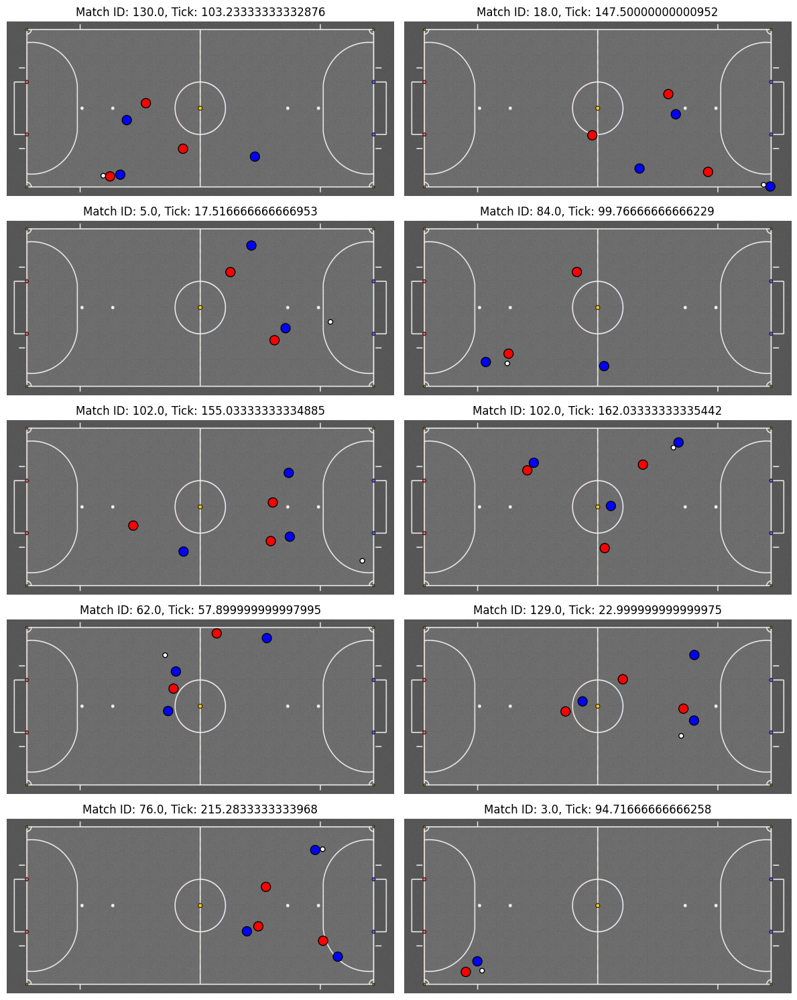

In [22]:
# Plots de momentos de partidos al azar

# Seleccionar aleatoriamente combinaciones de match_id y tick
unique_moments = data_posiciones[['match_id', 'time']].drop_duplicates()
random_moments = unique_moments.sample(n=10)

# Crear subplots
fig, axs = plt.subplots(5, 2, figsize=(12, 15))
axs = axs.ravel()  # Aplanar el array de ejes para facilitar el acceso

# Filtrar y graficar los datos para cada momento seleccionado
for i, (index, moment) in enumerate(random_moments.iterrows()):
    match_id = moment['match_id']
    tick = moment['time']
    
    # Filtrar datos para el momento actual
    moment_data = data_posiciones[(data_posiciones['match_id'] == match_id) & (data_posiciones['time'] == tick)]
    
    # Graficar los datos en el subplot correspondiente
    ax = axs[i]
    ax.imshow(background_image, extent=[-605, 605, -255, 255], aspect='auto')
    
    # Asignar colores y tamaños según el equipo
    colors = moment_data['team'].map({'0': 'white', '1': 'red', '2': 'blue'})
    sizes = moment_data['team'].map({'0': 25, '1': 100, '2': 100})
    
    scatter = ax.scatter(moment_data['x'], moment_data['y'], c=colors, s=sizes, edgecolors='black')
    ax.set_title(f'Match ID: {match_id}, Tick: {tick}')
    ax.set_xlim([-605, 605])
    ax.set_ylim([-255, 255])
    ax.axis('off')  # Opcional: para ocultar los ejes

plt.tight_layout()
plt.show()

match_id seleccionado: 54
Cantidad de ticks (momentos) captados: 80


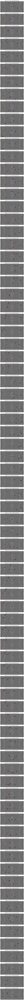

In [23]:
# Ploteo un partido entero, momento por momento
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Seleccionar un match_id al azar
random_match_id = 54 #data_posiciones['match_id'].sample(1).iloc[0]
print('match_id seleccionado:', random_match_id)

# Filtrar todos los momentos de ese partido
match_data = data_posiciones[data_posiciones['match_id'] == random_match_id].sort_values('time')

# Extraer los ticks únicos
ticks = match_data['time'].unique()
print('Cantidad de ticks (momentos) captados:',len(ticks))

fig, axs = plt.subplots(len(ticks), 1, figsize=(6, len(ticks) * 3))
axs = axs.ravel()  # Aplanar el array de ejes para facilitar el acceso

# Cargar la imagen de fondo de la cancha de fútbol
background_image = mpimg.imread('C:/Users/ASROCK/Desktop/haxball_ai/maps/x3_bazinga.PNG')

# Iterar sobre cada tick y mostrar el gráfico correspondiente
for i, frame in enumerate(ticks):
    # Filtrar datos para el momento actual
    moment_data = match_data[match_data['time'] == frame]
    
    # Graficar los datos en el subplot correspondiente
    ax = axs[i]
    ax.imshow(background_image, extent=[-605, 605, -255, 255], aspect='auto')
    
    # Asignar colores y tamaños según el equipo
    colors = moment_data['team'].map({'0': 'white', '1': 'red', '2': 'blue'})
    sizes = moment_data['team'].map({'0': 25, '1': 100, '2': 100})
    
    scatter = ax.scatter(moment_data['x'], moment_data['y'], c=colors, s=sizes, edgecolors='black')
    ax.set_title(f'Match ID: {random_match_id}, Tick: {frame}')
    ax.set_xlim([-605, 605])
    ax.set_ylim([-255, 255])
    ax.axis('off')  # Opcional: para ocultar los ejes
    
# Mostrar el gráfico
plt.tight_layout()
plt.show()

### Etiquetando algunos datos

In [19]:
# Crear nuevas columnas en nuevo dataframe de etiquetado, inicializadas con 'none' para indicar si habrá gol en los próximos 'n' ticks

data_grouped_entities_7ents_labeled = data_grouped_entities_7ents
data_grouped_entities_7ents_labeled['gol_1_ticks'] = 'none'
data_grouped_entities_7ents_labeled['gol_2_ticks'] = 'none'
data_grouped_entities_7ents_labeled['gol_3_ticks'] = 'none'
data_grouped_entities_7ents_labeled['gol_4_ticks'] = 'none'
data_grouped_entities_7ents_labeled['gol_5_ticks'] = 'none'
data_grouped_entities_7ents_labeled['gol_6_ticks'] = 'none'

# Crear un diccionario para acceso rápido a los goles por match_id
goles_dict = data_goles.groupby('match_id').apply(lambda x: x[['tick', 'equipo']].to_dict('records')).to_dict()

C:\Users\ASROCK\AppData\Local\Temp\ipykernel_17656\2042237518.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_grouped_entities_7ents_labeled['gol_1_ticks'] = 'none'
C:\Users\ASROCK\AppData\Local\Temp\ipykernel_17656\2042237518.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_grouped_entities_7ents_labeled['gol_2_ticks'] = 'none'
C:\Users\ASROCK\AppData\Local\Temp\ipykernel_17656\2042237518.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

In [20]:
# Iterar sobre las filas de data_grouped_entities_7ents
for index, row in data_grouped_entities_7ents.iterrows():
    match_id = row['match_id']
    time = row['time']
    
    if match_id in goles_dict:
        goles = goles_dict[match_id]
        
        # Filtrar goles futuros a partir del tiempo actual
        futuros_goles = [gol for gol in goles if gol['tick'] > time]
        
        for offset in range(1, 7):  # Revisar para ticks 1, 2, 3, 4, 5 y 6
            gol_cercano = next((gol['equipo'] for gol in futuros_goles if gol['tick'] <= time + offset), 'none')
            col_name = f'gol_{offset}_ticks'
            data_grouped_entities_7ents.at[index, col_name] = gol_cercano


In [21]:
# Verificar resultados solo para match_id elegido
match_id_test = 54
data_grouped_entities_7ents_match_id_test = data_grouped_entities_7ents[data_grouped_entities_7ents['match_id'] == match_id_test]

# Configurar para mostrar todas las filas y columnas
pd.set_option('display.max_rows', None)  # Muestra todas las filas
pd.set_option('display.max_columns', None)  # Muestra todas las columnas
pd.set_option('display.expand_frame_repr', False)  # Evita que las columnas se corten

# Muestra una muestra aleatoria o todas las filas del match_id 54
data_grouped_entities_7ents_match_id_test

,match_id,time,entities,gol_1_ticks,gol_2_ticks,gol_3_ticks,gol_4_ticks,gol_5_ticks,gol_6_ticks
4562,54,0.633333,7,none,none,none,none,none,none
4563,54,1.633333,7,none,none,none,none,none,none
4564,54,2.633333,7,none,none,none,none,none,none
4565,54,3.633333,7,none,none,none,none,none,none
4566,54,4.633333,7,none,none,none,none,none,none
4567,54,5.633333,7,none,none,none,none,none,none
4568,54,6.633333,7,none,none,none,none,none,none
4569,54,7.633333,7,none,none,none,none,none,Blue
4570,54,8.633333,7,none,none,none,none,Blue,Blue
4571,54,9.633333,7,none,none,none,Blue,Blue,Blue


In [22]:
# Configurar para volver a los valores estandar de las filas y columnas
pd.reset_option('display.max_rows')
pd.reset_option('display.max_columns')
pd.reset_option('display.expand_frame_repr')

### Posicionamiento en la cancha de todos los jugadores en un partido

match_id seleccionado: 76
Resultado del partido: Equipo Red 3 - 2 Equipo Blue


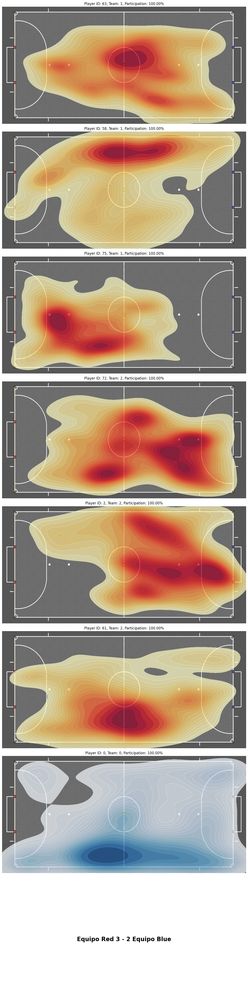

In [28]:
# Mapa de calor de todos los jugadores en un partido
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.image as mpimg

# Proporcionar el match_id deseado
match_id = 76  # Cambia esto al match_id deseado
print('match_id seleccionado:', match_id)

# Contar los goles de cada equipo en el partido
goles_red = data_goles[(data_goles['match_id'] == match_id) & (data_goles['equipo'] == 'Red')].shape[0]
goles_blue = data_goles[(data_goles['match_id'] == match_id) & (data_goles['equipo'] == 'Blue')].shape[0]
resultado_partido = f'Equipo Red {goles_red} - {goles_blue} Equipo Blue'
print('Resultado del partido:', resultado_partido)

# Filtrar todos los momentos de ese partido
match_data = data_posiciones[data_posiciones['match_id'] == match_id]

# Obtener las combinaciones únicas de jugador y equipo en el partido
unique_combinations = match_data[['player_id', 'team']].drop_duplicates()

# Crear subplots
fig, axs = plt.subplots(len(unique_combinations) + 1, 1, figsize=(12, (len(unique_combinations) + 1) * 6))
axs = axs.ravel()  # Aplanar el array de ejes para facilitar el acceso

# Cargar la imagen de fondo de la cancha de fútbol
background_image = mpimg.imread('C:/Users/ASROCK/Desktop/haxball_ai/maps/x3_bazinga.PNG')

# Calcular el número total de momentos en el partido
total_moments = match_data['time'].nunique()

# Iterar sobre cada combinación jugador-equipo y crear su mapa de calor
for i, (index, row) in enumerate(unique_combinations.iterrows()):
    player_id = row['player_id']
    team = row['team']
    
    # Filtrar datos para el jugador y equipo actual
    player_team_data = match_data[(match_data['player_id'] == player_id) & (match_data['team'] == team)]
    
    # Calcular el porcentaje de momentos en los que el jugador estuvo presente
    player_moments = player_team_data['time'].nunique()
    participation_percentage = (player_moments / total_moments) * 100
    
    # Graficar la imagen de fondo
    ax = axs[i]
    ax.imshow(background_image, extent=[-605, 605, -255, 255], aspect='auto')

    # Gradiente de colores dependiendo de si es jugador o pelota
    if(player_id == 0):
        gradiente_de_colores = 'Blues'
    else:
        gradiente_de_colores = 'YlOrRd'

    
    # Crear el mapa de calor con la nueva paleta de colores y umbral ajustado
    sns.kdeplot(
        x=player_team_data['x'], y=player_team_data['y'], 
        fill=True, cmap=gradiente_de_colores, ax=ax, 
        bw_adjust=0.75, levels=20, thresh=0.1, alpha=0.7 # Umbral ajustado
    )
    
    ax.set_title(f'Player ID: {player_id}, Team: {team}, Participation: {participation_percentage:.2f}%')
    ax.set_xlim([-605, 605])
    ax.set_ylim([-255, 255])
    ax.axis('off')  # Opcional: para ocultar los ejes

# Añadir el resultado del partido en el último subplot
ax = axs[-1]
ax.text(0.5, 0.5, resultado_partido, horizontalalignment='center', verticalalignment='center', transform=ax.transAxes, fontsize=20, weight='bold')
ax.axis('off')  # Ocultar los ejes

# Mostrar el gráfico
plt.tight_layout()
plt.show()

### Distribución de la pelota en todos los partidos de la base de datos

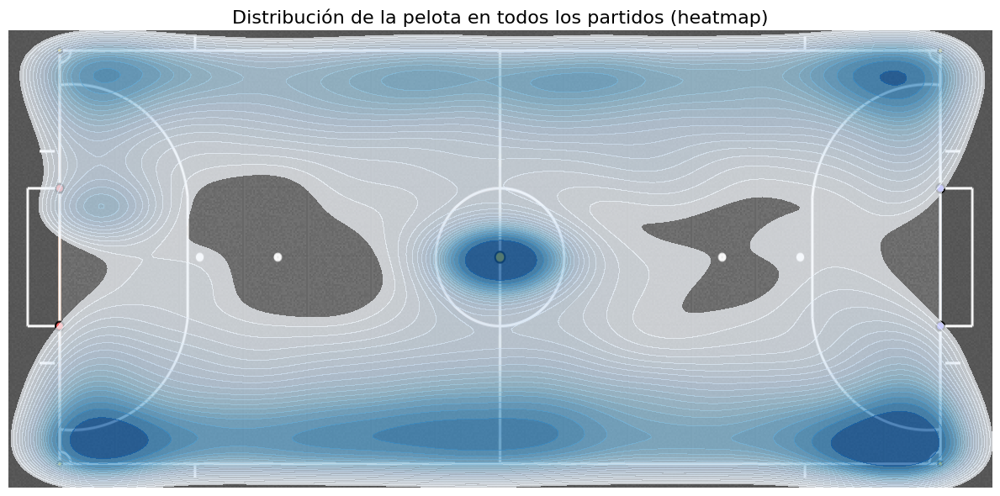

In [23]:
# Mapa de calor de la pelota en todos los partidos de la base de datos
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Filtrar solo las posiciones de la pelota
ball_data = data_posiciones[data_posiciones['player_id'] == 0]

# Crear el gráfico
plt.figure(figsize=(12, 6))
plt.imshow(background_image, extent=[-605, 605, -255, 255], aspect='auto')

# Crear el mapa de calor para las posiciones de la pelota
sns.kdeplot(
    x=ball_data['x'], y=ball_data['y'], 
    fill=True, cmap='Blues', bw_adjust=0.75, levels=20, thresh=0.1, alpha=0.7
)

# Configurar límites y ocultar ejes
plt.xlim([-605, 605])
plt.ylim([-255, 255])
plt.axis('off')  # Ocultar ejes

# Título
plt.title('Distribución de la pelota en todos los partidos (heatmap)', fontsize=16)

# Mostrar el gráfico
plt.tight_layout()
plt.show()

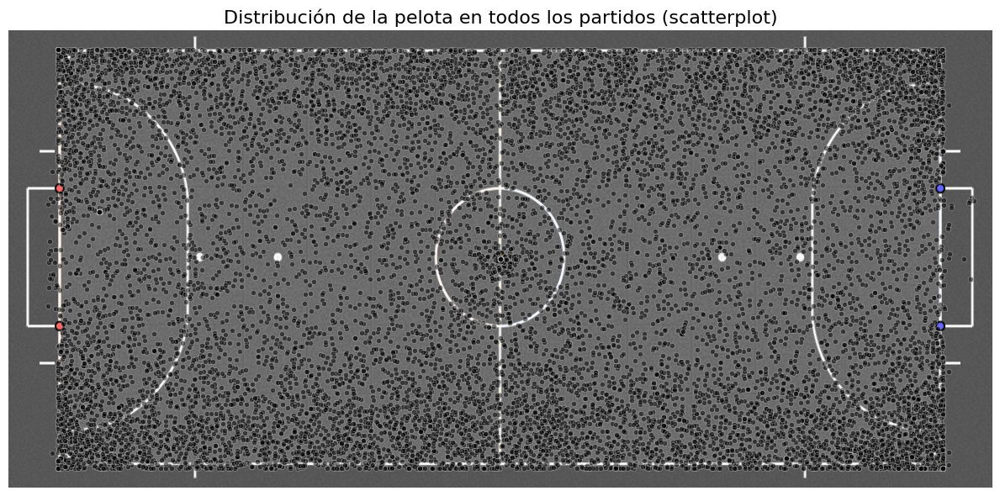

In [24]:
plt.figure(figsize=(12, 6))
plt.imshow(background_image, extent=[-605, 605, -255, 255], aspect='auto')

sns.scatterplot(
    x=ball_data['x'], y=ball_data['y'],
    color='Black', edgecolor='White', s=20, alpha=0.5
)

plt.xlim([-605, 605])
plt.ylim([-255, 255])
plt.axis('off')  # Ocultar ejes

plt.title('Distribución de la pelota en todos los partidos (scatterplot)', fontsize=16)

# Mostrar el gráfico
plt.tight_layout()
plt.show()

### Posicionamiento de la pelota antes de un gol en menos de n ticks, para cada equipo

In [30]:
cf.plot_ball_heatmaps_for_team_goal(equipo='Red', title_prefix='Distribución de la pelota: ', data_pos=data_posiciones, data_grouped=data_grouped_entities_7ents)

AttributeError: module 'custom_functions' has no attribute 'plot_ball_heatmaps_for_team_goal'

In [31]:
cf.plot_ball_heatmaps_for_team_goal(equipo='Blue', title_prefix='Distribución de la pelota:', data_pos=data_posiciones, data_grouped=data_grouped_entities_7ents)

AttributeError: module 'custom_functions' has no attribute 'plot_ball_heatmaps_for_team_goal'

## Filtrado de datos
Filtro datos que no me interesa tener en cuenta. A continuacion se enumeran, y se muestran algunas listas de ids o dataframes relevantes en cada caso:
* ids partidos que cumplen con el criterio del 90%: ids_90_percent_true
* ids de momentos no repetidos: ids_not_in_kickoff
* ids de momentos en los que no se está en kickoff: ids_not_in_kickoff_nor_cero
* ids de partidos con desorden en los registros de momentos: ids_out_of_order_matches
* ids de partidos con desorden en los registros de goles: ids_out_of_order_goals_matches
* ids de momentos en los que habian 7 entidades en cancha: ids_filtered_7ents_moments
* ids de partidos que sobrevivieron el filtrado (por lo menos con un momento del partido): ids_filtered

En la siguiente tabla se coloca informacion relevante sobre cada filtro, y se la analiza al finalizar el filtrado.

In [62]:
tabla_de_filtros = {
    'filtro': ['ninguno'],
    'cant_de_momentos': [data_posiciones.shape[0]],
    '%_respecto_a_original': [100],
    '%_respecto_a_anterior': [100]
}
data_filtros = pd.DataFrame(tabla_de_filtros)
previous_shape = data_posiciones.shape # Variable para futuros analisis de resultados de filtrados

#### Obtengo ids de partidos que cumplen con el criterio del 90%
* Un partido cumple con el criterio del 90% si en dicho porcentaje de los momentos (ticks) de los que se tienen registro del partido tienen exactamente 7 entidades en el campo de juego.
* Este criterio fue creado con el fin de obtener los ids de los partidos en los que la mayoria del tiempo se jugo en igualdad de condiciones, y los equipo no estuvieron en desventaja. Seran estos los partidos que serviran de base para el filtrado, pues son los que probablemente se hayan desarrollado en las mejores condiciones de igualdad y competencia.
* El criterio no tiene en cuenta jugadores afk, que hacen presencia pero no estan moviendose. Sin embargo, como me importan las posiciones y velocidades, he decidido ignorar de momento esta condicion.
* Ademas, se da por centado que al haber 7 entidades en la cancha, una es la pelopta y las otras 6 se reparten en partes iguales por equipo. Sin enbargo esto podria no ser verdad, y que haya por ejemplo 4 del Red y 2 del Blue. Se decide confiar en el manejo de los admins de turno.

In [63]:
# Vuelvo a crear y utilizar data_grouped_entities
data_grouped_entities = data_posiciones.groupby(['match_id', 'time']).size().reset_index(name='entities')
data_grouped_entities['match_id'].unique()

array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
        14,  15,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,  27,
        28,  29,  30,  31,  32,  33,  35,  36,  37,  38,  39,  40,  41,
        42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,  53,  54,
        55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  66,  67,  68,
        69,  70,  71,  72,  73,  74,  75,  76,  77,  78,  79,  80,  81,
        82,  83,  84,  85,  86,  87,  88,  89,  90,  91,  92,  93,  94,
        95,  96,  97,  98,  99, 100, 101, 102, 103, 104, 105, 106, 107,
       108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120,
       121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133,
       134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146,
       149, 150], dtype=int64)

In [64]:
# Calculo para cada partido si se cumple con el criterio del 90%
partidos_90_percent_criteria = data_grouped_entities.loc[:, ['match_id']].drop_duplicates(subset=['match_id'])
partidos_90_percent_criteria['90%_criteria'] = np.nan

ids = data_grouped_entities['match_id'].unique()

for id_ in ids:
    data_from_matchid = data_grouped_entities[data_grouped_entities['match_id'] == id_]
    ents_7 =  data_from_matchid[data_from_matchid['entities'] == 7].shape[0]
    ents_nan =  data_from_matchid[pd.notna(data_from_matchid['entities'])].shape[0]
    total = data_from_matchid.shape[0]

    if (ents_7 / (total)) >= 0.90:
        partidos_90_percent_criteria.loc[partidos_90_percent_criteria['match_id'] == id_, '90%_criteria'] = True
    else:
        partidos_90_percent_criteria.loc[partidos_90_percent_criteria['match_id'] == id_, '90%_criteria'] = False

print(partidos_90_percent_criteria.sample(10))

       match_id 90%_criteria
11710       121         True
7363         79         True
3027         37        False
11018       113        False
13267       133        False
11102       114        False
10758       110         True
4562         54         True
2619         30         True
2940         33        False


In [65]:
columnas_90_percent_for_valuecounts = ['90%_criteria']
cf.print_value_counts(partidos_90_percent_criteria, 'partidos_90_percent_criteria' , 2, columnas_90_percent_for_valuecounts)

Value counts para partidos_90_percent_criteria - Columna: 90%_criteria
90%_criteria
True     97
False    48
Name: count, dtype: int64




In [66]:
# Obtengo los ids de los partidos qque cumple con el criterio
ids_90_percent_true = partidos_90_percent_criteria[partidos_90_percent_criteria['90%_criteria'] == True]['match_id'].unique()
ids_90_percent_true

array([ 12,  13,  14,  15,  17,  18,  19,  20,  22,  23,  24,  25,  26,
        27,  28,  29,  30,  31,  32,  42,  43,  44,  45,  46,  47,  48,
        50,  51,  52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  63,
        64,  66,  67,  68,  69,  70,  71,  72,  73,  75,  76,  77,  78,
        79,  80,  88,  89,  90,  92,  93,  95,  96,  97,  98,  99, 100,
       101, 102, 103, 104, 109, 110, 111, 115, 116, 117, 119, 121, 122,
       123, 124, 126, 127, 128, 129, 130, 132, 134, 135, 136, 137, 138,
       140, 141, 142, 144, 145, 146], dtype=int64)

In [67]:
data_posiciones_filtered = data_posiciones[data_posiciones['match_id'].isin(ids_90_percent_true)]
data_posiciones_filtered.sample(5)

,id,match_id,player_id,x,y,velocity_x,velocity_y,time,team
33666,35981,60,63,389.303611,-128.636948,-104.823521,32.474680,17.000000,2
79539,81854,121,0,-543.750000,129.180168,-42.461018,-56.369470,170.416667,0
37562,39877,66,67,498.600125,48.395861,-24.333133,133.041334,23.200000,2
58100,60415,92,91,-265.637041,72.216957,7.010542,-97.975027,170.033333,2
95763,98078,144,137,436.793337,-28.833472,-8.502736,121.786778,49.233333,1


In [68]:
data_posiciones.shape[0]

97712

In [69]:
# Cantidad de filas que quedaron luego del filtrado
print("Cantidad de filas que quedaron luego del filtrado:", data_posiciones_filtered.shape[0])
print("Porcentaje de filas que quedan del dataset original:", round((data_posiciones_filtered.shape[0]/data_posiciones.shape[0]*100), 2),"%")
print("Porcentaje de filas que quedan del dataset filtrado anterior:", round((data_posiciones_filtered.shape[0]/previous_shape[0]*100), 2),"%")

# Guardo la informacion en el dataframe de filtrado
fila = {
    'filtro': 'criterio del 90%',
    'cant_de_momentos': data_posiciones_filtered.shape[0],
    '%_respecto_a_original': round((data_posiciones_filtered.shape[0]/data_posiciones.shape[0]*100), 2),
    '%_respecto_a_anterior': round((data_posiciones_filtered.shape[0]/previous_shape[0]*100), 2)
}
fila = pd.DataFrame([fila])
data_filtros =  pd.concat([data_filtros, fila], ignore_index=True)

previous_shape = data_posiciones_filtered.shape # Me la guardo para futuras comparaciones de filtrados

Cantidad de filas que quedaron luego del filtrado: 86156
Porcentaje de filas que quedan del dataset original: 88.17 %
Porcentaje de filas que quedan del dataset filtrado anterior: 88.17 %


In [ ]:
data_filtros = analizar_filtrado(data_filtros, data_posiciones.shape[0], data_posiciones_filtered.shape[0], previous_shape[0])

#### No es saque del medio
* Se filtra si el tiempo es cero o si hay un par 'player_id'-'time' repetido. Se mira que ningun jugador este repetido en el mismo equipo, es decir, que no tengan el mismo id. Aqui no se tiene en cuenta que, dado que el id es por nickname, podrian haber jugadores con el mismo nick que esten jugando. Como estos casos de momentos son muy excepcionales (y no pase en el 99.99% de los partidos), se deciden filtrar igual.

In [70]:
data_posiciones_filtered_grouped = data_posiciones_filtered.groupby(['match_id', 'time', 'player_id']).size().reset_index(name='cant_de_duplicados')
data_posiciones_filtered_grouped['cant_de_duplicados'].value_counts()

cant_de_duplicados
1     84607
4       125
5        89
3        77
6        28
8         7
14        7
7         7
2         1
Name: count, dtype: int64

In [71]:
data_posiciones_filtered_merged = pd.merge(data_posiciones_filtered, data_posiciones_filtered_grouped, on=['match_id', 'time', 'player_id'], how='left')
data_posiciones_filtered_merged.sample(10)

,id,match_id,player_id,x,y,velocity_x,velocity_y,time,team,cant_de_duplicados
35419,42057,68,69,-105.072305,-155.956565,70.000346,-86.331716,85.900000,2,1
30230,36415,60,63,476.885224,-55.472872,50.311671,18.546234,79.000000,2,1
12652,17344,26,22,339.922757,74.595759,108.484565,-35.600069,26.533333,2,1
52494,62603,95,97,331.836163,-75.160789,-0.108027,-0.737687,55.483333,2,1
22740,28925,50,2,181.061316,0.000000,-99.388384,0.000000,2.666667,2,1
66674,78751,117,119,307.692156,52.056389,-58.907469,33.309205,70.000000,1,1
15645,20337,32,23,-3.993904,-111.598589,136.269769,-36.462938,68.400000,1,1
49779,59828,92,92,296.683490,75.165685,98.872507,70.481028,86.033333,2,1
77760,90877,132,112,-241.767386,12.834030,26.899628,3.078596,73.650000,1,1
72827,85573,126,120,79.077184,132.692782,75.899085,125.726964,70.450000,1,1


In [72]:
ids_not_in_kickoff = data_posiciones_filtered_merged[data_posiciones_filtered_merged['cant_de_duplicados'] == 1]['id']
ids_not_in_kickoff

28        4680
29        4681
30        4682
31        4683
32        4684
         ...  
86151    99644
86152    99645
86153    99646
86154    99647
86155    99648
Name: id, Length: 84607, dtype: int64

In [73]:
# Saco los momentos con triplas 'match_id' - 'tick' - 'player_id' repetidas (son instancias que se cargaron mal en la base)
data_posiciones_filtered = data_posiciones_filtered_merged[data_posiciones_filtered_merged['id'].isin(ids_not_in_kickoff)]
data_posiciones_filtered.sample(10)

,id,match_id,player_id,x,y,velocity_x,velocity_y,time,team,cant_de_duplicados
70031,82439,122,123,-324.607247,-14.361703,21.072430,42.372799,62.100000,1,1
63491,74884,111,112,154.636132,142.583953,-23.489162,-2.650051,14.333333,2,1
35599,42237,69,69,192.771768,46.986878,-129.224901,-42.307003,22.166667,2,1
15746,20438,32,38,-303.949321,-47.192078,-134.951091,64.139727,82.400000,2,1
51732,61781,93,94,-254.079979,145.971917,7.589819,5.810238,129.100000,1,1
33658,40296,66,0,-483.755236,-194.058325,53.135249,10.655937,82.200000,0,1
22886,29071,50,0,-81.925693,-202.781346,-151.641207,-0.386667,22.666667,0,1
30322,36507,60,53,454.196819,-90.665475,39.343789,28.792625,92.000000,2,1
28838,35023,58,58,399.114221,-140.504195,-2.273198,-76.519149,158.116667,2,1
21353,27511,47,49,-1.049193,-149.413632,-16.692182,-137.059650,67.633333,1,1


In [74]:
# Saco los momentos con tiempo igual a 0 (cero)
data_posiciones_filtered = data_posiciones_filtered[data_posiciones_filtered['time'] > 0]
ids_not_in_kickoff_nor_cero = data_posiciones_filtered['id']
ids_not_in_kickoff_nor_cero

28        4680
29        4681
30        4682
31        4683
32        4684
         ...  
86151    99644
86152    99645
86153    99646
86154    99647
86155    99648
Name: id, Length: 84586, dtype: int64

In [75]:
# Cantidad de filas que quedaron luego del filtrado
print("Cantidad de filas que quedaron luego del filtrado:", data_posiciones_filtered.shape[0])
print("Porcentaje de filas que quedan del dataset original:", round((data_posiciones_filtered.shape[0]/data_posiciones.shape[0]*100), 2),"%")
print("Porcentaje de filas que quedan del dataset filtrado anterior:", round((data_posiciones_filtered.shape[0]/previous_shape[0]*100), 2),"%")

# Guardo la informacion en el dataframe de filtrado
fila = {
    'filtro': 'kickoffs y time=0',
    'cant_de_momentos': data_posiciones_filtered.shape[0],
    '%_respecto_a_original': round((data_posiciones_filtered.shape[0]/data_posiciones.shape[0]*100), 2),
    '%_respecto_a_anterior': round((data_posiciones_filtered.shape[0]/previous_shape[0]*100), 2)
}
fila = pd.DataFrame([fila])
data_filtros =  pd.concat([data_filtros, fila], ignore_index=True)

previous_shape = data_posiciones_filtered.shape # Me la guardo para futuras comparaciones de filtrados

Cantidad de filas que quedaron luego del filtrado: 84586
Porcentaje de filas que quedan del dataset original: 86.57 %
Porcentaje de filas que quedan del dataset filtrado anterior: 98.18 %


#### Orden de los goles e instancias de partidos
Se quiere desechar todo partido cuyo registro de goles y momentos no tengan un orden cronologico adecuado.

In [76]:
# Chequeo orden en los registros de las posiciones
data_posiciones_sorted = data_posiciones_filtered.sort_values(by=['match_id', 'id']).copy()
print(data_posiciones_sorted)

prev_time = None
prev_match_id = None
is_time_ordered = []

# Iterar por cada fila para verificar la condición de orden
for index, row in data_posiciones_sorted.iterrows():
    current_time = row['time']
    current_match_id = row['match_id']
    
    if prev_match_id is None:  # Primera fila, se inicializa
        is_time_ordered.append(True)
    else:
        if current_match_id == prev_match_id:
            # Mismo match_id, el tiempo debe ser mayor o igual
            is_time_ordered.append(current_time >= prev_time)
        else:
            # Nuevo match_id, el tiempo debe reiniciarse
            is_time_ordered.append(current_time <= prev_time)
    
    # Actualizar variables para la próxima iteración
    prev_time = current_time
    prev_match_id = current_match_id

# Agregar la columna de resultado al DataFrame
data_posiciones_sorted['is_time_ordered'] = is_time_ordered

# Mostrar el resultado: partidos donde el orden no es correcto
out_of_order_matches = data_posiciones_sorted[~data_posiciones_sorted['is_time_ordered']]
ids_out_of_order_matches = out_of_order_matches['match_id'].unique()

# Mostrar la lista de match_id con desorden
print("Match IDs con desorden en la columna 'time':")
print(ids_out_of_order_matches)


          id  match_id  player_id           x           y  velocity_x  \
28      4680        12          8   27.453888  -21.167838  167.632673   
29      4681        12          9  451.063365    0.000000    2.214649   
30      4682        12         11   58.645781   18.255905  -29.037540   
31      4683        12          2 -336.986776  130.570316   24.399796   
32      4684        12         13 -181.004729 -116.840617   62.716972   
...      ...       ...        ...         ...         ...         ...   
86151  99644       146        134  191.159030    6.232646   24.448374   
86152  99645       146        137   34.971503  103.170949    5.469465   
86153  99646       146        139 -363.568821   40.963755  -88.810229   
86154  99647       146        140 -479.389414  -71.904191   -0.876417   
86155  99648       146          0 -516.563229  -68.750651   18.686187   

       velocity_y        time team  cant_de_duplicados  
28     -99.190320    0.533333    1                   1  
29       

In [77]:
# Chequeo orden en los registros de los goles
data_goles_filtered = data_goles[data_goles['match_id'].isin(ids_90_percent_true)]
data_goles_filtered = data_goles_filtered.dropna(subset = ['tick'])

data_goles_sorted = data_goles_filtered.sort_values(by=['match_id', 'id']).copy()
print(data_goles_sorted.head(10))

prev_goal_time = None
prev_match_id = None
is_goals_time_ordered = []

# Iterar por cada fila para verificar la condición de orden
for index, row in data_goles_sorted.iterrows():
    current_time = row['tick']
    current_match_id = row['match_id']
    #print(current_match_id, ',', current_time, prev_goal_time)
    
    if prev_match_id is None:  # Primera fila, se inicializa
        is_goals_time_ordered.append(True)
    else:
        if current_match_id == prev_match_id:
            # Mismo match_id, el tiempo debe ser mayor o igual
            is_goals_time_ordered.append(current_time >= prev_goal_time)
        else:
            # Nuevo match_id, el tiempo debe reiniciarse
            is_goals_time_ordered.append(True)
    
    # Actualizar variables para la próxima iteración
    prev_goal_time = current_time
    prev_match_id = current_match_id


# Agregar la columna de resultado al DataFrame
data_goles_filtered['is_goals_time_ordered'] = is_goals_time_ordered

# Mostrar el resultado: partidos donde el orden no es correcto
out_of_order_goals_matches = data_goles_filtered[~data_goles_filtered['is_goals_time_ordered']]
ids_out_of_order_goals_matches = out_of_order_goals_matches['match_id'].unique()

# Mostrar la lista de match_id con desorden
print("Match IDs con desorden en la columna 'time':")
print(ids_out_of_order_goals_matches)


      id  match_id  player_id  player_name equipo        tick
94   163        42         46         Nico    Red   11.866667
95   164        42          2          tnt    Red   34.316667
96   165        42          2          tnt    Red   61.766667
97   166        43         50  carrascketa    Red  195.716667
98   167        44          2          tnt    Red   27.916667
99   168        45         47         pijo   Blue   44.833333
100  169        45         50  carrascketa   Blue  121.100000
101  170        45         48      marco!"   Blue  151.300000
102  171        46         48      marco!"   Blue   16.266667
103  172        46         46         Nico   Blue   29.483333
Match IDs con desorden en la columna 'time':
[63]


In [78]:
# Saco los momentos con triplas 'match_id' - 'tick' - 'player_id' repetidas (son instancias que se cargaron mal en la base)
data_posiciones_filtered = data_posiciones_filtered[~data_posiciones_filtered['match_id'].isin(ids_out_of_order_matches)]
print(data_posiciones_filtered.shape[0])
data_posiciones_filtered = data_posiciones_filtered[~data_posiciones_filtered['match_id'].isin(ids_out_of_order_goals_matches)]
print(data_posiciones_filtered.shape[0])
print(data_posiciones_filtered.sample(10))

82190
82190
          id  match_id  player_id           x           y  velocity_x  \
76986  89732       130          2 -336.378813   58.865743 -105.568509   
74758  87504       128          0  432.950994  164.134946   71.984027   
75618  88364       129        112 -378.054254   99.197294  -37.962853   
73961  86707       127        112 -533.050419  -61.531659    0.165941   
23202  29387        50          2 -400.456920  204.211465  -81.895989   
12858  17550        26          2   -4.132648 -111.456796  137.150882   
55445  65554        97         97 -140.714786   -1.863264    5.784000   
7548   12200        20          0  521.886159 -225.726051   18.854048   
2573    7225        14         18  -90.752509  176.803198  -32.622326   
56672  66781        98         40  205.221555  109.121665  132.392178   

       velocity_y        time team  cant_de_duplicados  
76986  103.715377  125.233333    2                   1  
74758   -0.011097   92.466667    0                   1  
75618   41.76

In [79]:
# Cantidad de filas que quedaron luego del filtrado
print("Cantidad de filas que quedaron luego del filtrado:", data_posiciones_filtered.shape[0])
print("Porcentaje de filas que quedan del dataset original:", round((data_posiciones_filtered.shape[0]/data_posiciones.shape[0]*100), 2),"%")
print("Porcentaje de filas que quedan del dataset filtrado anterior:", round((data_posiciones_filtered.shape[0]/previous_shape[0]*100), 2),"%")

# Guardo la informacion en el dataframe de filtrado
fila = {
    'filtro': 'orden',
    'cant_de_momentos': data_posiciones_filtered.shape[0],
    '%_respecto_a_original': round((data_posiciones_filtered.shape[0]/data_posiciones.shape[0]*100), 2),
    '%_respecto_a_anterior': round((data_posiciones_filtered.shape[0]/previous_shape[0]*100), 2)
}
fila = pd.DataFrame([fila])
data_filtros =  pd.concat([data_filtros, fila], ignore_index=True)

previous_shape = data_posiciones_filtered.shape # Me la guardo para futuras comparaciones de filtrados

Cantidad de filas que quedaron luego del filtrado: 82190
Porcentaje de filas que quedan del dataset original: 84.11 %
Porcentaje de filas que quedan del dataset filtrado anterior: 97.17 %


#### Momentos con 7 entidades
* Se eliminan las instancias en las que no habian exactamente 7 entidades en el campo de juego. 

In [80]:
data_grouped_entities_filtered = data_posiciones_filtered.groupby(['match_id', 'time']).size().reset_index(name='entities')
data_grouped_entities_filtered['entities'].value_counts()

entities
7    11705
6       41
8        1
1        1
Name: count, dtype: int64

In [81]:
data_grouped_entities_filtered

,match_id,time,entities
0,12,0.533333,7
1,12,1.533333,7
2,12,2.533333,7
3,12,3.533333,7
4,12,4.533333,7
...,...,...,...
11743,146,175.266667,7
11744,146,176.266667,7
11745,146,177.266667,7
11746,146,178.266667,7


In [82]:
data_grouped_entities_filtered_7ents = data_grouped_entities_filtered[data_grouped_entities_filtered['entities'] == 7]
data_posiciones_filtered_7ents = pd.merge(data_posiciones_filtered, data_grouped_entities_filtered_7ents[['match_id', 'time']], on=['match_id', 'time'], how='inner')
data_posiciones_filtered_7ents.sample(7)

,id,match_id,player_id,x,y,velocity_x,velocity_y,time,team,cant_de_duplicados
36536,46232,73,63,-51.426715,-79.671241,-135.434644,11.204393,131.133333,1,1
12880,18991,30,24,-9.512704,181.670672,-13.014629,14.426230,29.800000,1,1
70819,87498,128,112,399.066711,128.579833,91.726604,-17.955591,92.466667,1,1
53563,67286,98,0,456.028585,37.387946,125.805606,-57.951149,172.783333,0,1
55249,69006,101,99,-212.276268,-19.616431,53.290745,-0.820732,136.733333,1,1
68712,85391,126,120,105.741851,39.766843,139.951402,19.740470,44.450000,1,1
50295,63875,96,2,-45.768993,100.361332,141.073054,14.336964,66.416667,1,1


In [83]:
ids_filtered_7ents_moments = data_posiciones_filtered_7ents['id']

In [84]:
data_posiciones_filtered = data_posiciones_filtered_7ents

In [85]:
# Cantidad de filas que quedaron luego del filtrado
print("Cantidad de filas que quedaron luego del filtrado:", data_posiciones_filtered.shape[0])
print("Porcentaje de filas que quedan del dataset original:", round((data_posiciones_filtered.shape[0]/data_posiciones.shape[0]*100), 2),"%")
print("Porcentaje de filas que quedan del dataset filtrado anterior:", round((data_posiciones_filtered.shape[0]/previous_shape[0]*100), 2),"%")

# Guardo la informacion en el dataframe de filtrado
fila = {
    'filtro': '7ents',
    'cant_de_momentos': data_posiciones_filtered.shape[0],
    '%_respecto_a_original': round((data_posiciones_filtered.shape[0]/data_posiciones.shape[0]*100), 2),
    '%_respecto_a_anterior': round((data_posiciones_filtered.shape[0]/previous_shape[0]*100), 2)
}
fila = pd.DataFrame([fila])
data_filtros =  pd.concat([data_filtros, fila], ignore_index=True)

previous_shape = data_posiciones_filtered.shape # Me la guardo para futuras comparaciones de filtrados

Cantidad de filas que quedaron luego del filtrado: 81935
Porcentaje de filas que quedan del dataset original: 83.85 %
Porcentaje de filas que quedan del dataset filtrado anterior: 99.69 %


#### Con goles registrados
* Se eliminan los partidos en los que no existia registro del tiempo en la tabla 'goles'. Estos son los partidos con match_id mayor a 36 (hubo un error en el registro de ese dato hasta ese partido).

In [86]:
data_posiciones_filtered = data_posiciones_filtered[data_posiciones_filtered['match_id'] >= 37 ]
ids_with_goal_tick = data_posiciones_filtered['match_id'].unique()
ids_with_goal_tick

array([ 42,  43,  44,  45,  46,  47,  48,  50,  51,  52,  53,  54,  55,
        56,  57,  58,  59,  60,  61,  66,  67,  68,  69,  70,  71,  72,
        73,  75,  76,  77,  78,  79,  80,  88,  89,  90,  92,  93,  95,
        96,  97,  98,  99, 100, 101, 102, 103, 104, 109, 110, 111, 115,
       116, 117, 119, 121, 122, 123, 124, 126, 127, 128, 129, 130, 132,
       134, 135, 136, 137, 138, 140, 141, 142, 144, 145, 146], dtype=int64)

In [87]:
# Cantidad de filas que quedaron luego del filtrado
print("Cantidad de filas que quedaron luego del filtrado:", data_posiciones_filtered.shape[0])
print("Porcentaje de filas que quedan del dataset original:", round((data_posiciones_filtered.shape[0]/data_posiciones.shape[0]*100), 2),"%")
print("Porcentaje de filas que quedan del dataset filtrado anterior:", round((data_posiciones_filtered.shape[0]/previous_shape[0]*100), 2),"%")

# Guardo la informacion en el dataframe de filtrado
fila = {
    'filtro': 'goals_with_ticks',
    'cant_de_momentos': data_posiciones_filtered.shape[0],
    '%_respecto_a_original': round((data_posiciones_filtered.shape[0]/data_posiciones.shape[0]*100), 2),
    '%_respecto_a_anterior': round((data_posiciones_filtered.shape[0]/previous_shape[0]*100), 2)
}
fila = pd.DataFrame([fila])
data_filtros =  pd.concat([data_filtros, fila], ignore_index=True)

previous_shape = data_posiciones_filtered.shape # Me la guardo para futuras comparaciones de filtrados

Cantidad de filas que quedaron luego del filtrado: 67011
Porcentaje de filas que quedan del dataset original: 68.58 %
Porcentaje de filas que quedan del dataset filtrado anterior: 81.79 %


#### Momentos con 1 pelota, 3 del Red, y 3 del blue 
* Se eliminan las instancias en las que no habian exactamente 1 pelota, 3 del Red, 3 del Blue en el campo de juego.

#### ... faltan filtrar ...

In [88]:
# tick (tabla goles) != NULL (no se registro el tick en el que se hizo el gol).

In [89]:
# en (tabla goles) filtrar cuando en un partido hay mas de 5 goles, o menos de 1 gol, o no coincidan los ticks en orden (en SQL)
# esto ocurre en el match_id '63', donde se registran 2 partidos diferentes como el mismo por error; ver 
#                   SELECT * FROM goles WHERE match_id = 63
# en query de SQL.

#### Analisis de filtrado
Algunos numeros de como disminuyo el numero de filas al pasar por los diferentes filtros

In [90]:
data_filtros.head(10)

,filtro,cant_de_momentos,%_respecto_a_original,%_respecto_a_anterior
0,ninguno,97712,100.00,100.00
1,criterio del 90%,86156,88.17,88.17
2,kickoffs y time=0,84586,86.57,98.18
3,orden,82190,84.11,97.17
4,7ents,81935,83.85,99.69
5,goals_with_ticks,67011,68.58,81.79


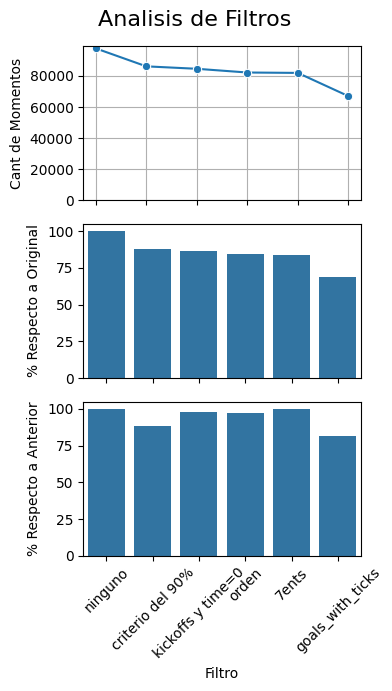

In [91]:
fig, axs = plt.subplots(3, 1, figsize=(4, 7), )

sns.lineplot(data=data_filtros, x='filtro', y='cant_de_momentos', marker='o', ax=axs[0])
#axs[0].set_title('Cant de Momentos por Filtro')
axs[0].set_xlabel('')
axs[0].set_ylabel('Cant de Momentos')
axs[0].grid(True)
axs[0].set_ylim(0,)
axs[0].set_xticklabels([])  # Oculto etiquetas del eje x

sns.barplot(data=data_filtros, x='filtro', y='%_respecto_a_original', ax=axs[1])
#axs[1].set_title('% Respecto a Original por Filtro')
axs[1].set_xlabel('')
axs[1].set_ylabel('% Respecto a Original')
axs[1].set_ylim(0,)
axs[1].grid(False)
axs[1].set_xticklabels([])  # Oculto etiquetas del eje x

sns.barplot(data=data_filtros, x='filtro', y='%_respecto_a_anterior', ax=axs[2])
#axs[2].set_title('% Respecto a Anterior por Filtro')
axs[2].set_xlabel('Filtro')
axs[2].set_ylabel('% Respecto a Anterior')
axs[2].set_ylim(0,)
axs[2].grid(False)
axs[2].tick_params(axis='x', rotation=45)  # Roto etiquetas del eje x

fig.suptitle('Analisis de Filtros', fontsize=16) # Titulo principal

plt.tight_layout()

plt.show()

#### Migro los datos filtrados

In [92]:
# Migro datos de posiciones (ya filtrado)
ruta_archivo = os.path.join('./filtered_data', 'data_posiciones_filtered.csv')
data_posiciones_filtered.to_csv(ruta_archivo, index=False)

In [93]:
# ids de partidos que pasaron el filtrado
ids_filtered = data_posiciones_filtered['match_id'].unique()
ids_filtered

array([ 42,  43,  44,  45,  46,  47,  48,  50,  51,  52,  53,  54,  55,
        56,  57,  58,  59,  60,  61,  66,  67,  68,  69,  70,  71,  72,
        73,  75,  76,  77,  78,  79,  80,  88,  89,  90,  92,  93,  95,
        96,  97,  98,  99, 100, 101, 102, 103, 104, 109, 110, 111, 115,
       116, 117, 119, 121, 122, 123, 124, 126, 127, 128, 129, 130, 132,
       134, 135, 136, 137, 138, 140, 141, 142, 144, 145, 146], dtype=int64)

In [94]:
data_goles_filtered = data_goles[data_goles['match_id'].isin(ids_filtered)]
data_goles_filtered.sample(7)

,id,match_id,player_id,player_name,equipo,tick
111,180,50,44,.,Blue,97.400000
214,283,88,80,fff,Blue,67.950000
126,195,55,48,"marco!""",Blue,65.216667
333,402,135,2,tnt,Blue,150.350000
118,187,53,57,MATT,Blue,83.950000
217,286,89,81,tR Salah,Red,72.583333
141,210,60,53,MERNOSKETTI,Red,153.283333


In [95]:
# Migro datos de posiciones (ya filtrado)
ruta_archivo = os.path.join('./filtered_data', 'data_goles_filtered.csv')
data_goles_filtered.to_csv(ruta_archivo, index=False)

## ...

In [ ]:
#